## Rental Vacancy Rates
#### Goal:
Explore the data relationships of all your features and understand how the features compare to the response variable.

● Build data profiles and tables

    ○ Inferential statistics
    
● Explore data relationships

    ○ Data visualization
    
● Feature Selection and Engineering

In [1]:
#Import pandas, matplotlib.pyplot, and seaborn
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import numpy as np
import scipy.stats as ss
from pandas_profiling import ProfileReport
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale

In [2]:
#get path to data
path= '/Users/josephfrasca/Coding_Stuff/Springboard/Capstone_2/data/interim'
os.chdir(path)
os.listdir()

['.gitkeep',
 '.ipynb_checkpoints',
 'ACS_rentsPrices_2011_2018.csv',
 'ACS_zillow_2011_2018.csv',
 'Annual_fredData_2011_2019',
 'df3_1956',
 'df_homePrices_2011_2018',
 'df_homePrices_2011_2020',
 'df_homePrices_2011_2020.csv',
 'df_rentPrices_2014_2020',
 'df_rentPrices_2014_2020.csv',
 'master_complete_for_EDA.csv',
 'vacancy_zillowHomeRent_merge_2014_2020.csv',
 'VacancyRate_Zipcode_2011_2018',
 'VacancyRate_Zipcode_2011_2018.csv',
 'VacancyRate_Zipcode_AND_National_2011_2020.csv',
 'zillow_rentPrices_2014_2020.csv']

In [3]:
# load cleaned data
df = pd.read_csv('master_complete_for_EDA.csv', dtype={'Zipcode': object})
df.dtypes

Zipcode                   object
RentPrice                float64
Year                       int64
SizeRank                 float64
State                     object
City                      object
Metro                     object
CountyName                object
HomePrice                float64
Vacancy_Rate%            float64
MOE-VacancyRate%         float64
int_rate                 float64
med_hIncome              float64
uspop_growth             float64
unemplt_rate             float64
newHouse_starts          float64
resConstruct_spending    float64
dtype: object

In [4]:
df

,Zipcode,RentPrice,Year,SizeRank,State,City,Metro,CountyName,HomePrice,Vacancy_Rate%,MOE-VacancyRate%,int_rate,med_hIncome,uspop_growth,unemplt_rate,newHouse_starts,resConstruct_spending
0,02333,1368.536,2011,8782.0,MA,East Bridgewater,Boston-Cambridge-Newton,Plymouth County,NaN,3.024027,2.199925,0.750000,57021.0,0.720018,8.933333,611.916667,255208.583333
1,02338,1311.076,2011,11179.0,MA,Halifax,Boston-Cambridge-Newton,Plymouth County,274920.17,3.116343,2.948791,0.750000,57021.0,0.720018,8.933333,611.916667,255208.583333
2,02339,1484.626,2011,8621.0,MA,Hanover,Boston-Cambridge-Newton,Plymouth County,415097.50,4.464646,2.066438,0.750000,57021.0,0.720018,8.933333,611.916667,255208.583333
3,02341,1266.816,2011,10079.0,MA,Hanson,Boston-Cambridge-Newton,Plymouth County,NaN,3.586322,2.340722,0.750000,57021.0,0.720018,8.933333,611.916667,255208.583333
4,02343,1524.006,2011,9640.0,MA,Holbrook,Boston-Cambridge-Newton,Norfolk County,247510.42,3.732901,2.926524,0.750000,57021.0,0.720018,8.933333,611.916667,255208.583333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
264955,98279,1059.870,2018,23400.0,WA,Olga,NaN,San Juan County,552805.42,51.219512,10.993457,2.458333,64324.0,0.522337,3.891667,1248.250000,564448.750000
264956,98280,993.850,2018,25265.0,WA,Eastsound,NaN,San Juan County,678499.00,51.329243,12.777549,2.458333,64324.0,0.522337,3.891667,1248.250000,564448.750000
264957,98311,1533.500,2018,4981.0,WA,Bremerton,Bremerton-Silverdale,Kitsap County,314320.83,6.540162,1.960476,2.458333,64324.0,0.522337,3.891667,1248.250000,564448.750000
264958,98326,778.990,2018,26185.0,WA,Clallam Bay,Port Angeles,Clallam County,150193.17,28.537736,14.679524,2.458333,64324.0,0.522337,3.891667,1248.250000,564448.750000


In [5]:
df[['Vacancy_Rate%', 'Zipcode', 'Year']]

,Vacancy_Rate%,Zipcode,Year
0,3.024027,02333,2011
1,3.116343,02338,2011
2,4.464646,02339,2011
3,3.586322,02341,2011
4,3.732901,02343,2011
...,...,...,...
264955,51.219512,98279,2018
264956,51.329243,98280,2018
264957,6.540162,98311,2018
264958,28.537736,98326,2018


In [6]:
#drop Margin of Error for Vacancy Rate
df = df.drop(['MOE-VacancyRate%'], axis=1)

In [7]:
df

,Zipcode,RentPrice,Year,SizeRank,State,City,Metro,CountyName,HomePrice,Vacancy_Rate%,int_rate,med_hIncome,uspop_growth,unemplt_rate,newHouse_starts,resConstruct_spending
0,02333,1368.536,2011,8782.0,MA,East Bridgewater,Boston-Cambridge-Newton,Plymouth County,NaN,3.024027,0.750000,57021.0,0.720018,8.933333,611.916667,255208.583333
1,02338,1311.076,2011,11179.0,MA,Halifax,Boston-Cambridge-Newton,Plymouth County,274920.17,3.116343,0.750000,57021.0,0.720018,8.933333,611.916667,255208.583333
2,02339,1484.626,2011,8621.0,MA,Hanover,Boston-Cambridge-Newton,Plymouth County,415097.50,4.464646,0.750000,57021.0,0.720018,8.933333,611.916667,255208.583333
3,02341,1266.816,2011,10079.0,MA,Hanson,Boston-Cambridge-Newton,Plymouth County,NaN,3.586322,0.750000,57021.0,0.720018,8.933333,611.916667,255208.583333
4,02343,1524.006,2011,9640.0,MA,Holbrook,Boston-Cambridge-Newton,Norfolk County,247510.42,3.732901,0.750000,57021.0,0.720018,8.933333,611.916667,255208.583333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
264955,98279,1059.870,2018,23400.0,WA,Olga,NaN,San Juan County,552805.42,51.219512,2.458333,64324.0,0.522337,3.891667,1248.250000,564448.750000
264956,98280,993.850,2018,25265.0,WA,Eastsound,NaN,San Juan County,678499.00,51.329243,2.458333,64324.0,0.522337,3.891667,1248.250000,564448.750000
264957,98311,1533.500,2018,4981.0,WA,Bremerton,Bremerton-Silverdale,Kitsap County,314320.83,6.540162,2.458333,64324.0,0.522337,3.891667,1248.250000,564448.750000
264958,98326,778.990,2018,26185.0,WA,Clallam Bay,Port Angeles,Clallam County,150193.17,28.537736,2.458333,64324.0,0.522337,3.891667,1248.250000,564448.750000


### Build data profiles and tables

#### Inferential statistics

Hint: do any particular results in your data strike you as abnormal?

- ****

What hypotheses can you form (Null and Alternative hypotheses) which you could go on to test? 

 - **Null hypotheses: .**
 
 -**Alternative hyptotheses: **

Take some time to recall your statistical concepts, such as that the p-value of an observation is the probability of seeing data at least as extreme as that observation, on the assumption of the null hypothesis.

In [8]:
#profilet = ProfileReport(df_test)
#profilet

In [13]:
profile = ProfileReport(df)
profile

In [11]:
df.isna().sum()/len(df)*100

Zipcode                   0.000000
RentPrice                 7.513210
Year                      0.000000
SizeRank                 10.211353
State                    10.211353
City                     10.211353
Metro                    31.328502
CountyName               10.211353
HomePrice                14.107035
Vacancy_Rate%             0.000000
int_rate                  0.000000
med_hIncome               0.000000
uspop_growth              0.000000
unemplt_rate              0.000000
newHouse_starts           0.000000
resConstruct_spending     0.000000
dtype: float64

<AxesSubplot:xlabel='Year', ylabel='Vacancy_Rate%'>

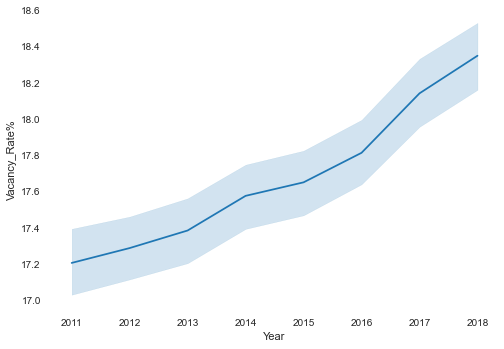

In [10]:
sns.lineplot(data=df, x="Year", y="Vacancy_Rate%")

<AxesSubplot:xlabel='Year', ylabel='RentPrice'>

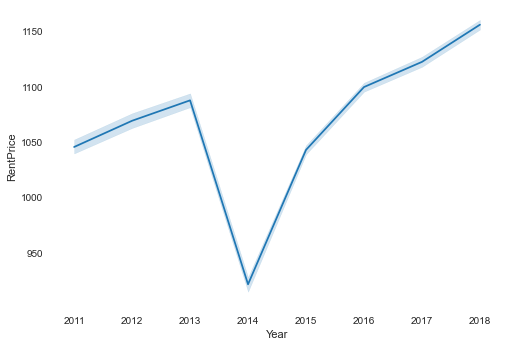

In [12]:
sns.lineplot(data=df, x="Year", y="RentPrice")

<AxesSubplot:xlabel='Year', ylabel='HomePrice'>

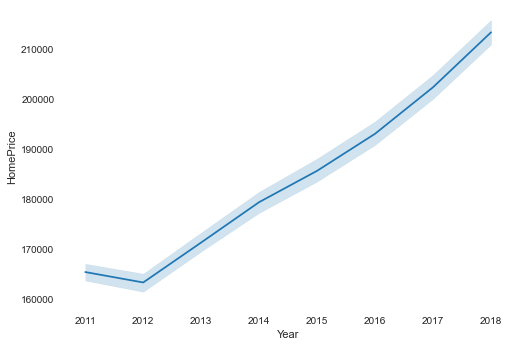

In [8]:
sns.lineplot(data=df, x="Year", y="HomePrice")

In [11]:
#filter for 2014-2018 for EDA
#tryint this due to large dip in rent prices from 2013-2014
#(believe this dip is due to different methods used in ACS data collection from 2014+)
df_2014_2018 = df[df['Year'] > 2013]

In [12]:
profile_14 = ProfileReport(df_2014_2018)
profile_14

### Notes

In [ ]:
#fix markdown for inferencial statistics

### Summar